In [3]:
# !pip install matplotlib

In [4]:
# !pip install seaborn

In [5]:
# !pip install geopy

  Using cached geopy-2.3.0-py3-none-any.whl (119 kB)
                                              0.0/40.3 kB ? eta -:--:--
     ---------------------------------------- 40.3/40.3 kB 1.9 MB/s eta 0:00:00


In [6]:
# !pip install folium

  Using cached folium-0.14.0-py2.py3-none-any.whl (102 kB)


In [7]:
# !pip install datetime

  Using cached DateTime-5.2-py3-none-any.whl (52 kB)


In [8]:
# !pip install scipy

In [11]:
# !pip install scikit-learn

In [10]:
# !pip install tensorflow

                                              0.0/276.6 MB ? eta -:--:--
                                            0.0/276.6 MB 991.0 kB/s eta 0:04:40
                                              0.2/276.6 MB 2.0 MB/s eta 0:02:21
                                              0.4/276.6 MB 3.0 MB/s eta 0:01:32
                                              0.7/276.6 MB 3.7 MB/s eta 0:01:16
                                              1.1/276.6 MB 5.0 MB/s eta 0:00:55
                                              1.4/276.6 MB 5.3 MB/s eta 0:00:53
                                              2.0/276.6 MB 6.3 MB/s eta 0:00:44
                                              2.1/276.6 MB 5.6 MB/s eta 0:00:50
                                              2.8/276.6 MB 6.9 MB/s eta 0:00:40
                                              3.4/276.6 MB 7.3 MB/s eta 0:00:38
                                              4.1/276.6 MB 8.4 MB/s eta 0:00:33
                                              4

In [24]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import geopy.distance
from math import radians,cos,sin,asin,sqrt
import folium
import datetime
from folium.plugins import HeatMap
from scipy.stats import ttest_ind

matplotlib.rcParams.update({'font.size': 12})

In [25]:
uber_data = pd.read_csv('data/uber-raw-data-jul14.csv')

In [26]:
uber_data.head(10)

,Date/Time,Lat,Lon,Base
0,7/1/2014 0:03:00,40.7586,-73.9706,B02512
1,7/1/2014 0:05:00,40.7605,-73.9994,B02512
2,7/1/2014 0:06:00,40.7320,-73.9999,B02512
3,7/1/2014 0:09:00,40.7635,-73.9793,B02512
4,7/1/2014 0:20:00,40.7204,-74.0047,B02512
5,7/1/2014 0:35:00,40.7487,-73.9869,B02512
6,7/1/2014 0:57:00,40.7444,-73.9961,B02512
7,7/1/2014 0:58:00,40.7132,-73.9492,B02512
8,7/1/2014 1:04:00,40.7590,-73.9730,B02512
9,7/1/2014 1:08:00,40.7601,-73.9823,B02512


In [27]:
type(uber_data.loc[0,'Date/Time'])

str

In [28]:
uber_data['Date/Time'] = pd.to_datetime(uber_data['Date/Time'])

In [29]:
type(uber_data.loc[0,'Date/Time'])

pandas._libs.tslibs.timestamps.Timestamp

In [31]:
##[0mins -15mins], [15mins - 30mins], [30mins - 45mins] and [45mins - 60mins]
uber_data['BinnedHour']=uber_data['Date/Time'].dt.floor('15min')

In [32]:
uber_data['BinnedHour']

0        2014-07-01 00:00:00
1        2014-07-01 00:00:00
2        2014-07-01 00:00:00
3        2014-07-01 00:00:00
4        2014-07-01 00:15:00
                 ...        
796116   2014-07-31 23:15:00
796117   2014-07-31 23:15:00
796118   2014-07-31 23:15:00
796119   2014-07-31 23:30:00
796120   2014-07-31 23:45:00
Name: BinnedHour, Length: 796121, dtype: datetime64[ns]

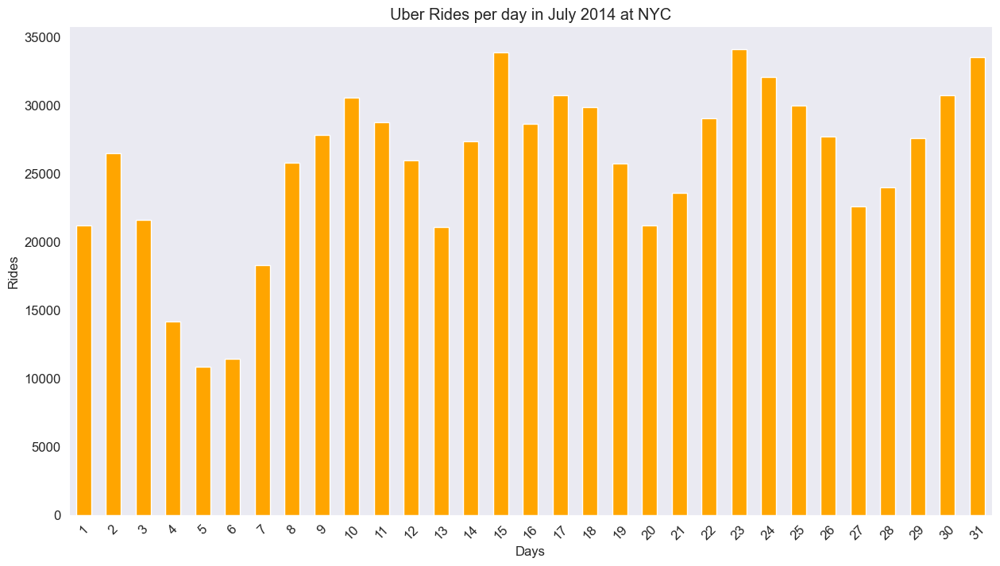

In [60]:
plt.figure(figsize=(15,8))
uber_data['BinnedHour'].dt.day.value_counts().sort_index().plot(kind='bar',color='orange')
for item in plt.gca().get_xticklabels():
    item.set_rotation(45)
plt.title('Uber Rides per day in July 2014 at NYC')
plt.xlabel('Days')
_=plt.ylabel('Rides')

In [34]:
##Observe the nearly recurring pattern in the data!. It is very noticable after day 11.

##Let us have a more closer look at it, say every 15 minutes from July 1 to July 31.

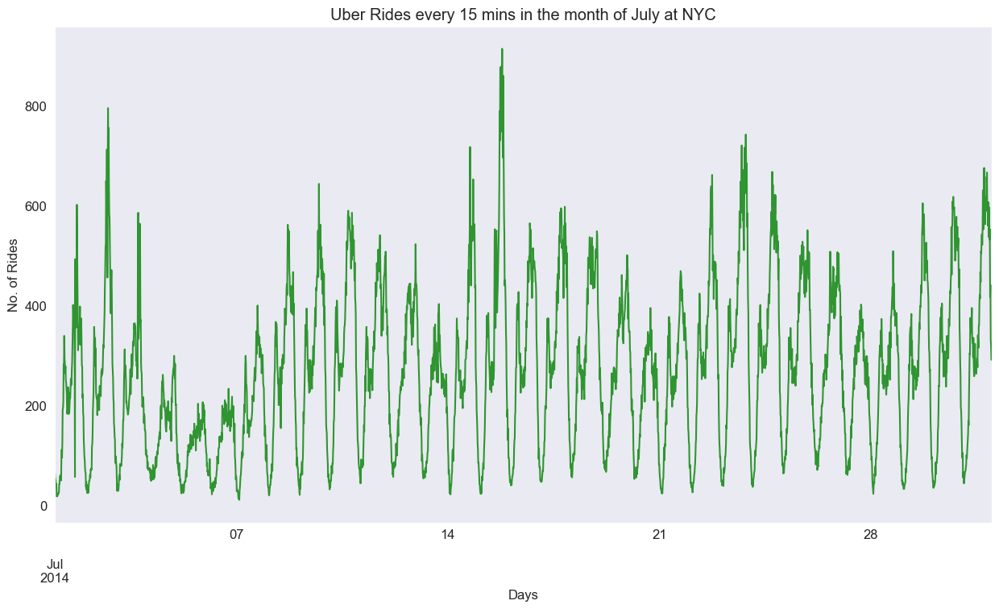

In [61]:
plt.figure(figsize=(15,8))
uber_data['BinnedHour'].value_counts().sort_index().plot(c='green',alpha=0.8)
plt.title('Uber Rides every 15 mins in the month of July at NYC')
plt.xlabel('Days')
_=plt.ylabel('No. of Rides')

## The underlying trend is clearly visible now. It conveys that in a day there are times when the pickups are very low and very high, and they seem to follow a pattern.

In [41]:
##times correspond to the highest and lowest peaks in the plot above
uber_data['BinnedHour'].value_counts()

2014-07-15 19:15:00    915
2014-07-15 18:15:00    879
2014-07-15 17:45:00    877
2014-07-15 18:00:00    872
2014-07-15 20:00:00    861
                      ... 
2014-07-01 02:00:00     17
2014-07-07 01:45:00     15
2014-07-07 02:15:00     14
2014-07-07 02:00:00     12
2014-07-07 02:30:00     10
Name: BinnedHour, Length: 2976, dtype: int64

## Now, Lets visualize the week wise trends in the data. For it, we have to map each date into its day name using a dictionary

In [43]:
#defining a dictionary to map the weekday to day name
DayMap={0:'Monday', 1:'Tuesday', 2:'Wednesday', 3:'Thursday', 4:'Friday', 5:'Saturday', 6:'Sunday'}
uber_data['Day']=uber_data['BinnedHour'].dt.weekday.map(DayMap)

In [44]:
#Separating the date to another column
uber_data['Date']=uber_data['BinnedHour'].dt.date

In [45]:
#Defining ordered category of week days for easy sorting and visualization
uber_data['Day']=pd.Categorical(uber_data['Day'],categories=['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'],ordered=True)

In [46]:
#Separating time from the "BinnedHour" Column
uber_data['Time']=uber_data['BinnedHour'].dt.time

In [47]:
##Rearranging the dataset for weekly analysis
weekly_data = uber_data.groupby(['Date','Day','Time']).count().dropna().rename(columns={'BinnedHour':'Rides'})['Rides'].reset_index()
weekly_data.head(10)

,Date,Day,Time,Rides
0,2014-07-01,Monday,00:00:00,0
1,2014-07-01,Monday,00:15:00,0
2,2014-07-01,Monday,00:30:00,0
3,2014-07-01,Monday,00:45:00,0
4,2014-07-01,Monday,01:00:00,0
5,2014-07-01,Monday,01:15:00,0
6,2014-07-01,Monday,01:30:00,0
7,2014-07-01,Monday,01:45:00,0
8,2014-07-01,Monday,02:00:00,0
9,2014-07-01,Monday,02:15:00,0


## Grouping weekly_data by days to plot total rides per week in july 2014.

In [48]:

#Grouping the weekly_data daywise
daywise = weekly_data.groupby('Day').sum()
daywise

C:\Users\SH REHEMAN\AppData\Local\Temp\ipykernel_3048\845895780.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  daywise = weekly_data.groupby('Day').sum()


,Rides
Day,
Monday,93189
Tuesday,137454
Wednesday,147717
Thursday,148439
Friday,102735
Saturday,90260
Sunday,76327


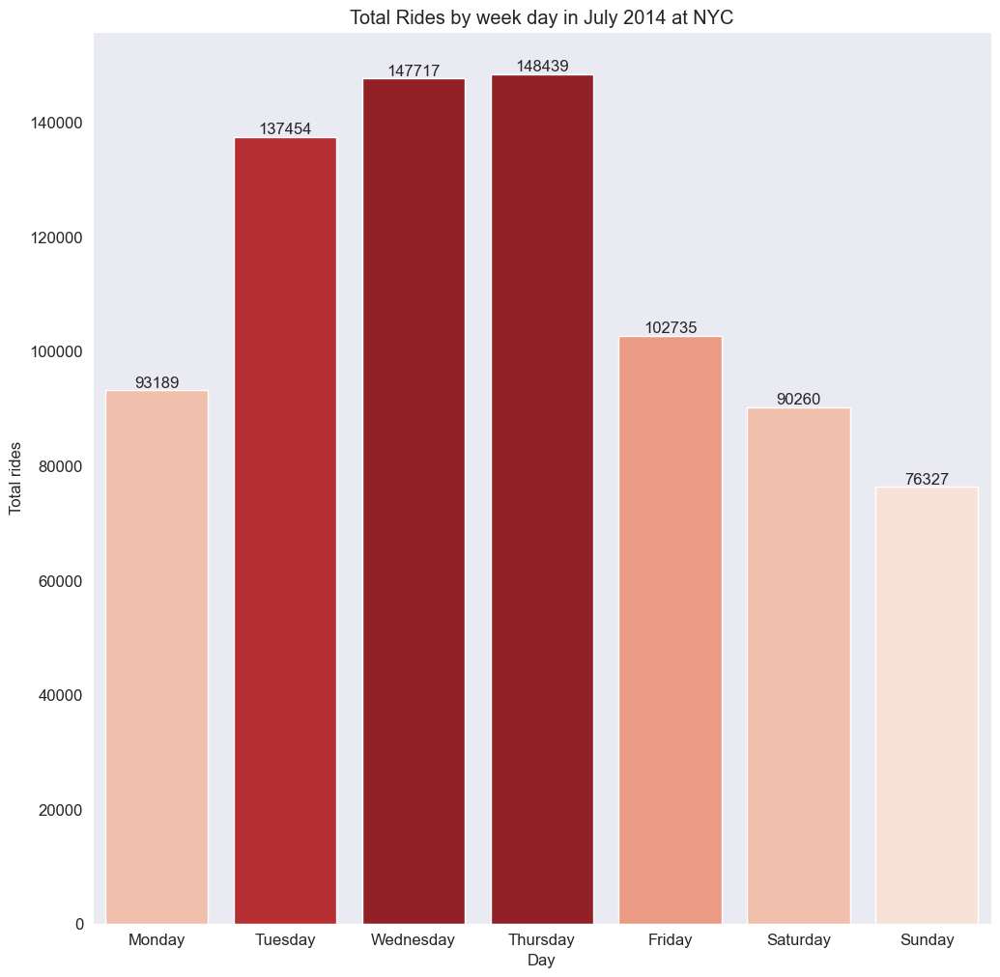

In [66]:
#Plotting the graphs for a better visualization
sns.set_style("dark")
plt.figure(figsize=(12,12))

#Creating a customized color palette for custom hue according to height of bars
vals = daywise.to_numpy().ravel()
normalized = (vals - np.min(vals)) / (np.max(vals) - np.min(vals))
indices = np.round(normalized * (len(vals) - 1)).astype(np.int32)
palette = sns.color_palette('Reds', len(vals))
colorPal = np.array(palette).take(indices, axis=0)

#Creating a bar plot
ax=sns.barplot(x = daywise.index,y= vals,palette=colorPal)
plt.ylabel('Total rides')
plt.title('Total Rides by week day in July 2014 at NYC')
for rect in ax.patches:
    ax.text(rect.get_x() + rect.get_width()/2.0,rect.get_height(),int(rect.get_height()), ha='center', va='bottom')

## According to the bar plot above, rides are maximum on Thursdays and minimum on Sundays. Sundays having the lowest number of rides makes sense logically, as it's a holiday and people often take rest on that day.

In [52]:
weekly_data = weekly_data.groupby(['Day','Time']).mean()['Rides']
weekly_data.head(10)

C:\Users\SH REHEMAN\AppData\Local\Temp\ipykernel_3048\23215704.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  weekly_data = weekly_data.groupby(['Day','Time']).mean()['Rides']


Day     Time    
Monday  00:00:00    13.225806
        00:15:00    10.967742
        00:30:00     8.741935
        00:45:00     7.709677
        01:00:00     6.935484
        01:15:00     5.354839
        01:30:00     3.838710
        01:45:00     3.645161
        02:00:00     2.612903
        02:15:00     3.161290
Name: Rides, dtype: float64

In [53]:
#Unstacking the data to create heatmap
weekly_data= weekly_data.unstack(level=0)
weekly_data

Day,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
Time,,,,,,,
00:00:00,13.225806,14.129032,18.096774,21.032258,24.677419,40.258065,36.709677
00:15:00,10.967742,13.290323,13.741935,17.645161,19.870968,38.419355,37.129032
00:30:00,8.741935,11.967742,14.387097,16.612903,19.096774,33.096774,34.903226
00:45:00,7.709677,9.290323,10.967742,14.064516,15.709677,31.483871,31.903226
01:00:00,6.935484,7.870968,10.129032,12.354839,15.483871,29.129032,31.322581
...,...,...,...,...,...,...,...
22:45:00,24.903226,37.741935,48.354839,64.064516,58.096774,50.258065,26.322581
23:00:00,22.225806,35.290323,41.258065,58.193548,56.129032,48.000000,21.258065
23:15:00,19.645161,28.096774,36.096774,47.516129,48.935484,45.032258,18.870968


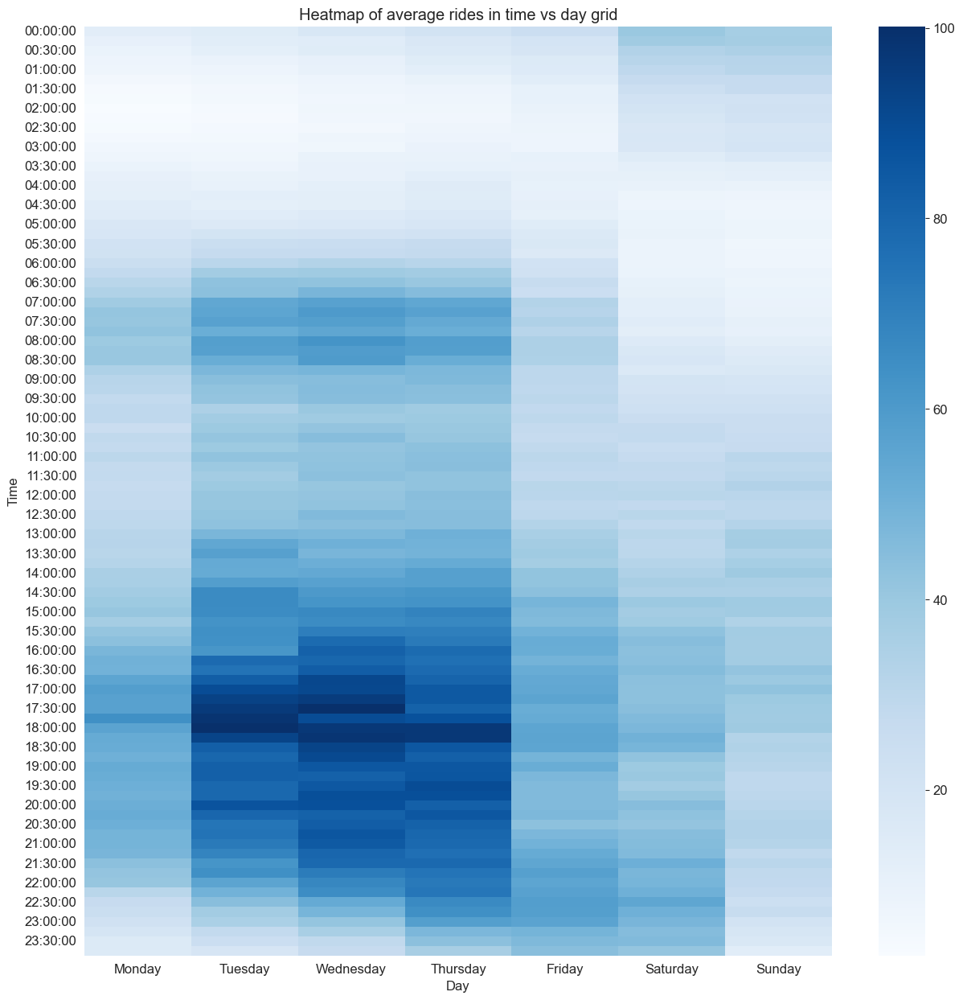

In [56]:
plt.figure(figsize=(15,15))
sns.heatmap(weekly_data,cmap='Blues')
_=plt.title('Heatmap of average rides in time vs day grid')

The heatmap indicates that the maximum average uber rides occur around 5:30PM to 6:15PM on Wednesdays and Thursdays and their values fall between 550 to 620.

### Here is another way of looking at it:

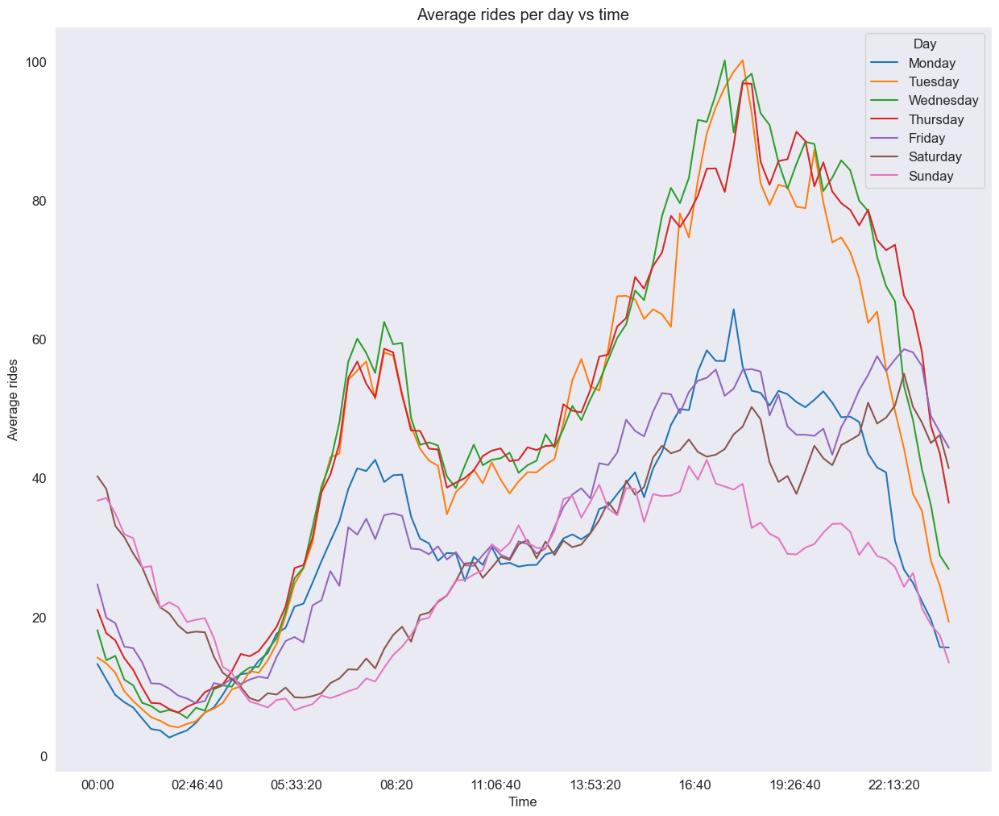

In [67]:
plt.figure(figsize=(15,12))
weekly_data.plot(ax=plt.gca())
_=plt.title('Average rides per day vs time')
_=plt.ylabel('Average rides')
plt.locator_params(axis='x', nbins=10)

### Finding average rides on any day

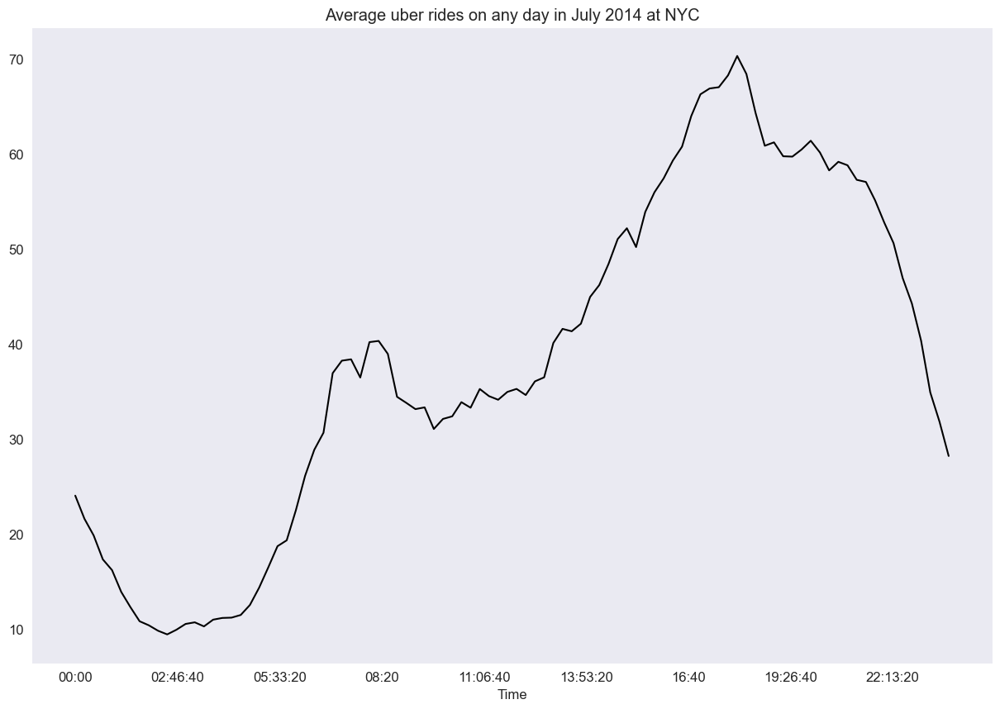

In [68]:
plt.figure(figsize=(15,10))
weekly_data.T.mean().plot(c = 'black')
_=plt.title('Average uber rides on any day in July 2014 at NYC')
plt.locator_params(axis='x', nbins=10)

### This plot further confirms that the average rides on any given day is lowest around 2 AM and highest in the around 5:30 PM.

### Now, let's try visualizing the relationship between Base and total number of rides in July 2014:

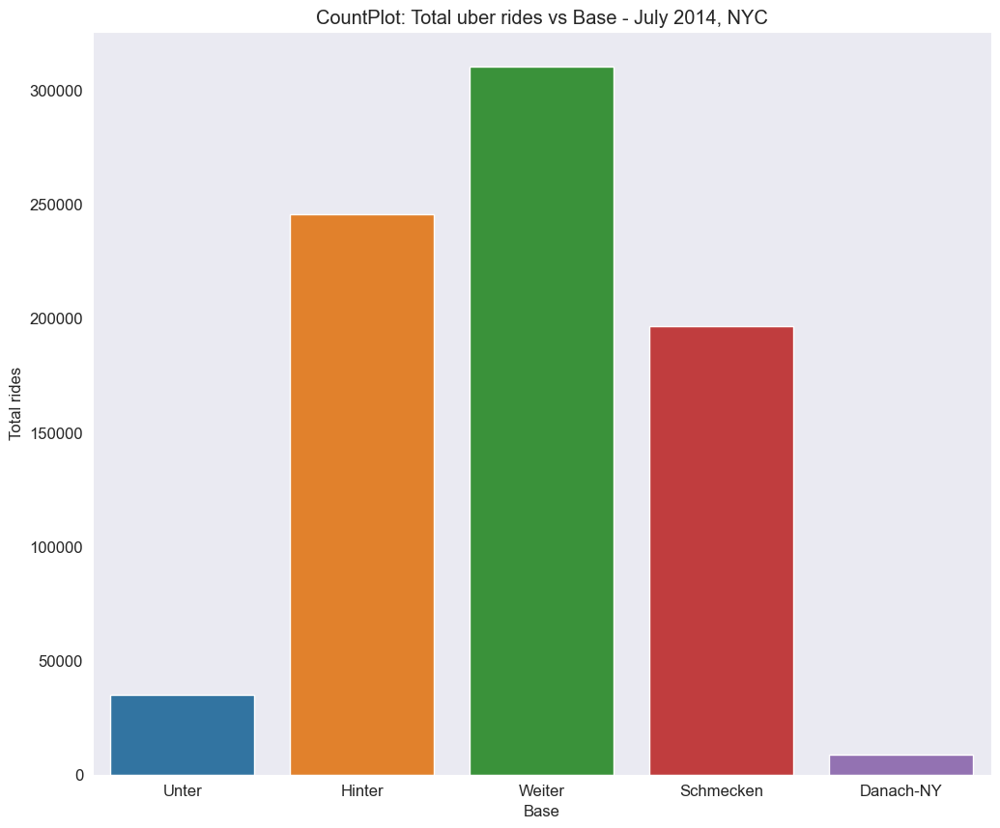

In [69]:
#A mapper to map base number with its name
BaseMapper={'B02512' : 'Unter', 'B02598' : 'Hinter', 'B02617' : 'Weiter', 'B02682' : 'Schmecken','B02764' : 'Danach-NY'}

#Count plot of Base
plt.figure(figsize=(12,10))
sns.set_style("dark")
_=sns.countplot(x=uber_data['Base'].map(BaseMapper))
plt.ylabel('Total rides')
_=plt.title('CountPlot: Total uber rides vs Base - July 2014, NYC')

#### The above plot tells us that most uber rides originated from Weiter Base and least from Danach-NY

#### To know more about the distribution of latitudes and longitudes, let's plot their histograms along with KDEs

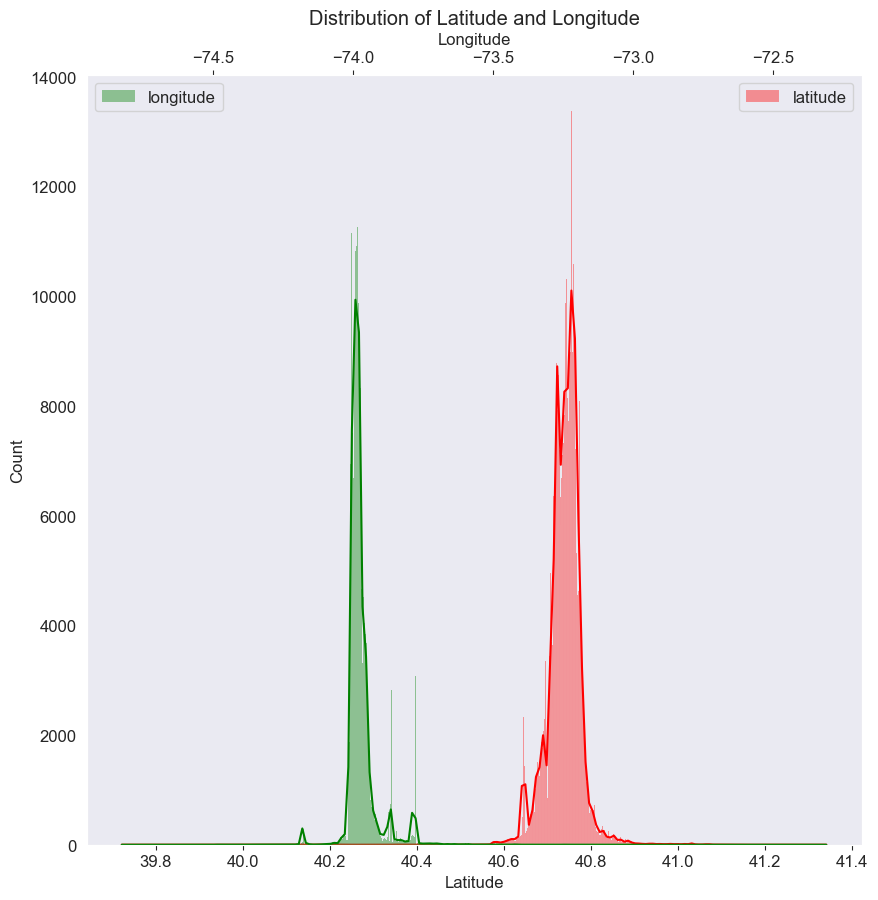

In [71]:
plt.figure(figsize=(10,10))
sns.histplot(uber_data['Lat'], bins='auto',kde=True,color='r',alpha=0.4,label = 'latitude')
plt.legend(loc='upper right')
plt.xlabel('Latitude')
plt.twiny()
sns.histplot(uber_data['Lon'], bins='auto',kde=True,color='g',alpha=0.4,label = 'longitude')
_=plt.legend(loc='upper left')
_=plt.xlabel('Longitude')
_=plt.title('Distribution of Latitude and Longitude')

#### Most latitudes are around 40.25, and longitudes around 40.75. This is true as the dataset comprises information only around New York City. This also indicates that most rides happen around (lat,lon) = (40.25,40.75)

### Let's display the latitude - longitude information in 2D:

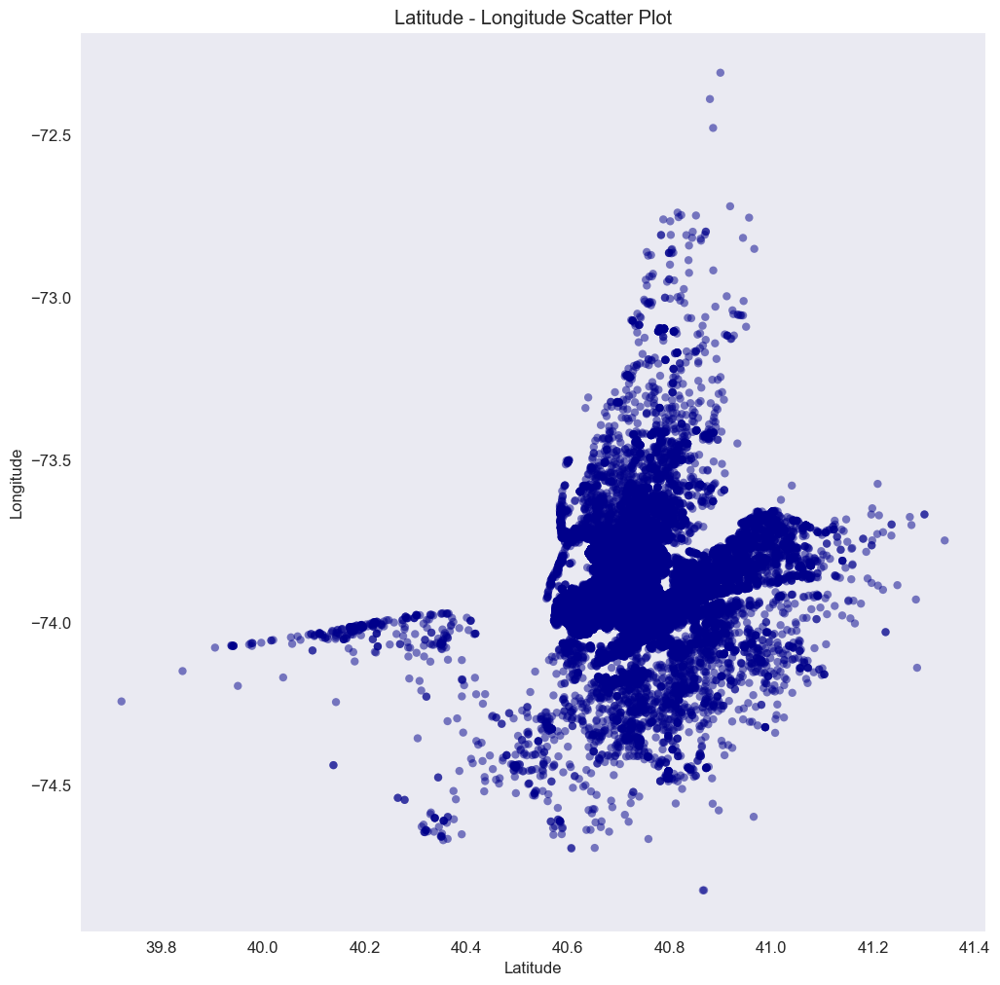

In [72]:
plt.figure(figsize=(12,12))
sns.scatterplot(x='Lat',y='Lon',data=uber_data,edgecolor='None',alpha=0.5,color='darkblue')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
_=plt.title('Latitude - Longitude Scatter Plot')

#### The dark blue area in the center shows the regions in New York City that had most number of uber rides in July 2014. The plot is better understood when a geographical map is placed underneath

#### Let's use geopy to calculate the distance between Metropolitan Museum and Emperical State Building

In [75]:
#This is an example of using geopy
metro_art_coordinates = (40.7794,-73.9632)
empire_state_building_coordinates = (40.7484,-73.9857)

distance = geopy.distance.distance(metro_art_coordinates,empire_state_building_coordinates)

print("Distance = ",distance)

Distance =  3.9319431838516716 km


#### Using geopy on a larger dataset may be time consuming on slower PC's. Hence let's use the haversine method

In [76]:
def haversine(coordinates1,coordinates2):
    
    lat1=coordinates1[0]
    lon1=coordinates1[1]
    lat2=coordinates2[0]
    lon2=coordinates2[1]
    
    #convert to radians and apply haverson formula
    lon1,lat1,lon2,lat2 = map(radians,[lon1,lat1,lon2,lat2])
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    
    a = sin(dlat/2)**2 + cos(lat1)*cos(lat2)*sin(dlon/2)**2
    c = 2*asin(sqrt(a))
    r = 3956
    return c*r
print("Distance (mi) = ",haversine(metro_art_coordinates,empire_state_building_coordinates))

Distance (mi) =  2.442501323483997


Now, Let's try to predict which place they are more closer to, say MM or ESB. This can be done by individually calculating the distance between each uber ride coordinates with MM or ESB coordinates. If they are found to be in a particular threshold radius with MM, then we can predict that the ride is going to MM. Similarly for ESB.

In [77]:
#calculating distance to MM and ESB for each point in the dataset
uber_data['Distance MM'] = uber_data[['Lat','Lon']].apply(lambda x: haversine(metro_art_coordinates,tuple(x)),axis=1)
uber_data['Distance ESB'] = uber_data[['Lat','Lon']].apply(lambda x: haversine(empire_state_building_coordinates,tuple(x)),axis=1)

In [ ]:
#printing the first 10 elements of the updated dataset
uber_data.head(10)

In [ ]:
#Now, let's keep a threshold of 0.25 miles and calculate the number of points that are closer to MM and ESB
#according to these thresholds

print((uber_data[['Distance MM','Distance ESB']]<0.25).sum())

The result above shows the number of rides predicted to MM and ESB

In [78]:
distance_range = np.arange(0.1,5.1,0.1)

In [79]:
distance_data = [(uber_data[['Distance MM','Distance ESB']] < dist).sum() for dist in distance_range]

In [80]:
distance_data

[Distance MM      575
 Distance ESB    2387
 dtype: int64,
 Distance MM     1776
 Distance ESB    9661
 dtype: int64,
 Distance MM      4566
 Distance ESB    22166
 dtype: int64,
 Distance MM      8783
 Distance ESB    42427
 dtype: int64,
 Distance MM     13606
 Distance ESB    68011
 dtype: int64,
 Distance MM     20770
 Distance ESB    92650
 dtype: int64,
 Distance MM      29408
 Distance ESB    119621
 dtype: int64,
 Distance MM      38912
 Distance ESB    147815
 dtype: int64,
 Distance MM      50497
 Distance ESB    177759
 dtype: int64,
 Distance MM      63072
 Distance ESB    206056
 dtype: int64,
 Distance MM      75474
 Distance ESB    240003
 dtype: int64,
 Distance MM      89442
 Distance ESB    277785
 dtype: int64,
 Distance MM     105692
 Distance ESB    311312
 dtype: int64,
 Distance MM     123431
 Distance ESB    335385
 dtype: int64,
 Distance MM     141656
 Distance ESB    355731
 dtype: int64,
 Distance MM     157194
 Distance ESB    375017
 dtype: int64,
 Distanc

In [81]:
#concatentate and transpose
distance_data = pd.concat(distance_data,axis=1)
distance_data = distance_data.T

In [82]:
#Shifting index 
distance_data.index = distance_range

In [83]:
distance_data=distance_data.rename(columns={'Distance MM':'CloserToMM','Distance ESB':'CloserToESB'})

Text(0, 0.5, 'Rides')

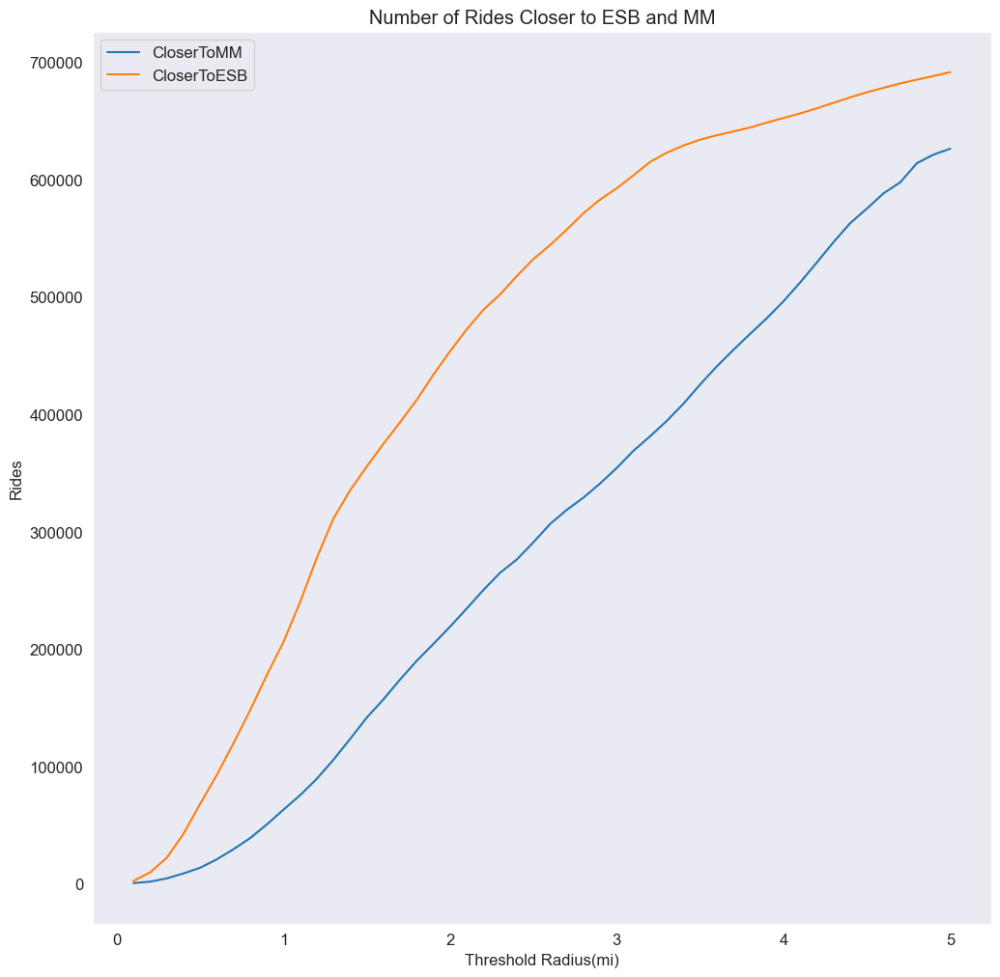

In [84]:
plt.figure(figsize=(12,12))
distance_data.plot(ax=plt.gca())
plt.title('Number of Rides Closer to ESB and MM')
plt.xlabel('Threshold Radius(mi)')
plt.ylabel('Rides')

The number of riders to MM and ESB initially diverges, but comes closer as threshold increases. Hence as radius increases, the rate of people going towards MM gets higher than that to ESB. In another way of thinking, as we expand the radius, most of the newly discovered rides are going to MM.

Now let us observe the heatmap plotted on geographical map (using folium)

In [85]:
#initilize the map around NYC and set the zoom level to 10
uber_map = folium.Map(location=metro_art_coordinates,zoom_start=10)

#lets mark MM and ESB on the map
folium.Marker(metro_art_coordinates,popup = "MM").add_to(uber_map)
folium.Marker(empire_state_building_coordinates,popup = "ESB").add_to(uber_map)

#convert to numpy array and plot it
Lat_Lon = uber_data[['Lat','Lon']].to_numpy()
folium.plugins.HeatMap(Lat_Lon,radius=10).add_to(uber_map)

#Displaying the map
uber_map

Lets reduce the "Influence" of each point on the heatmap by using a weight of 0.5 (by default it is 1)

In [86]:
uber_data['Weight']=0.5

#Take on 10000 points to plot (Just to speed up things)
Lat_Lon = uber_data[['Lat','Lon','Weight']].to_numpy()

#Plotting
uber_map = folium.Map(metro_art_coordinates,zoom_start=10)
folium.plugins.HeatMap(Lat_Lon,radius=15).add_to(uber_map)
uber_map

The plot looks easy to visualize now. Boundaries and intensity distribution is clear

Let's now create a HeatMap that changes with time. This will help us to visualize the number of uber rides geographically at a given time.

We are plotting only the points that are in a radius of 0.25 miles from MM or ESB

In [87]:
i = uber_data[['Distance MM','Distance ESB']] < 0.25

i.head(10)

,Distance MM,Distance ESB
0,False,False
1,False,False
2,False,False
3,False,False
4,False,False
5,False,True
6,False,False
7,False,False
8,False,False
9,False,False


In [88]:
#Create a boolean mask to choose the rides that satisfy the 0.25 radius threshold
i=i.any(axis=1)

i[i==True]

5         True
13        True
17        True
31        True
104       True
          ... 
795863    True
795910    True
795925    True
795940    True
796101    True
Length: 17897, dtype: bool

In [89]:
#Create a copy of the data
map_data = uber_data[i].copy()

#use a smaller weight
map_data['Weight'] = 0.1

#Restricting data to that before 8th july for faster calculations
map_data = uber_data[uber_data["BinnedHour"] < datetime.datetime(2014,7,8)].copy()

#Generate samples for each timestamp in "BinnedHour" (these are the points that are plotted for each timestamp)
map_data = map_data.groupby("BinnedHour").apply(lambda x: x[['Lat','Lon','Weight']].sample(int(len(x)/3)).to_numpy().tolist())

In [90]:
map_data

BinnedHour
2014-07-01 00:00:00    [[40.7814, -73.9797, 0.5], [40.6878, -73.739, ...
2014-07-01 00:15:00    [[40.7305, -73.9923, 0.5], [40.6532, -73.9561,...
2014-07-01 00:30:00    [[40.7456, -73.9992, 0.5], [40.7443, -74.0068,...
2014-07-01 00:45:00    [[40.6882, -73.9606, 0.5], [40.7159, -73.9953,...
2014-07-01 01:00:00    [[40.6968, -73.9961, 0.5], [40.7585, -73.9773,...
                                             ...                        
2014-07-07 22:45:00    [[40.667, -73.9819, 0.5], [40.7387, -73.9884, ...
2014-07-07 23:00:00    [[40.6463, -73.7901, 0.5], [40.7669, -73.9677,...
2014-07-07 23:15:00    [[40.721, -73.9989, 0.5], [40.733, -73.9864, 0...
2014-07-07 23:30:00    [[40.6445, -73.7827, 0.5], [40.74, -73.9799, 0...
2014-07-07 23:45:00    [[40.7372, -73.9968, 0.5], [40.7606, -73.9824,...
Length: 672, dtype: object

In [91]:
#The index to be passed on to heatmapwithtime needs to be a time series of the following format
data_hour_index = [x.strftime("%m%d%Y, %H:%M:%S") for x in map_data.index]

#convert to list to feed it to heatmapwithtime
date_hour_data = map_data.tolist()

#initialize map
uber_map = folium.Map(location=metro_art_coordinates,zoom_start=10)

In [92]:
#plotting
hm = folium.plugins.HeatMapWithTime(date_hour_data,index=date_hour_data)

#add heatmap to folium map(uber_map)
hm.add_to(uber_map)
uber_map

In [93]:
uber_data

,Date/Time,Lat,Lon,Base,BinnedHour,Day,Date,Time,Distance MM,Distance ESB,Weight
0,2014-07-01 00:03:00,40.7586,-73.9706,B02512,2014-07-01 00:00:00,Tuesday,2014-07-01,00:00:00,1.487358,1.058178,0.5
1,2014-07-01 00:05:00,40.7605,-73.9994,B02512,2014-07-01 00:00:00,Tuesday,2014-07-01,00:00:00,2.299140,1.100642,0.5
2,2014-07-01 00:06:00,40.7320,-73.9999,B02512,2014-07-01 00:00:00,Tuesday,2014-07-01,00:00:00,3.794105,1.354266,0.5
3,2014-07-01 00:09:00,40.7635,-73.9793,B02512,2014-07-01 00:00:00,Tuesday,2014-07-01,00:00:00,1.383450,1.094999,0.5
4,2014-07-01 00:20:00,40.7204,-74.0047,B02512,2014-07-01 00:15:00,Tuesday,2014-07-01,00:15:00,4.615925,2.173858,0.5
...,...,...,...,...,...,...,...,...,...,...,...
796116,2014-07-31 23:22:00,40.7285,-73.9846,B02764,2014-07-31 23:15:00,Thursday,2014-07-31,23:15:00,3.688336,1.375205,0.5
796117,2014-07-31 23:23:00,40.7615,-73.9868,B02764,2014-07-31 23:15:00,Thursday,2014-07-31,23:15:00,1.746524,0.906320,0.5
796118,2014-07-31 23:29:00,40.6770,-73.9515,B02764,2014-07-31 23:15:00,Thursday,2014-07-31,23:15:00,7.096685,5.244699,0.5
796119,2014-07-31 23:30:00,40.7225,-74.0038,B02764,2014-07-31 23:30:00,Thursday,2014-07-31,23:30:00,4.465889,2.023519,0.5


In [94]:
weekends = weekly_data[['Saturday','Sunday']]

In [95]:
weekdays = weekly_data.drop(['Saturday','Sunday'],axis=1)

In [96]:
weekends = weekends.mean(axis=1)
weekdays = weekdays.mean(axis=1)

In [97]:
weekdays_weekends = pd.concat([weekdays,weekends],axis=1)
weekdays_weekends.columns = ['Weekdays','Weekends']

In [98]:
weekdays_weekends

,Weekdays,Weekends
Time,,
00:00:00,18.232258,38.483871
00:15:00,15.103226,37.774194
00:30:00,14.161290,34.000000
00:45:00,11.548387,31.693548
01:00:00,10.554839,30.225806
...,...,...
22:45:00,46.632258,38.290323
23:00:00,42.619355,34.629032
23:15:00,36.058065,31.951613


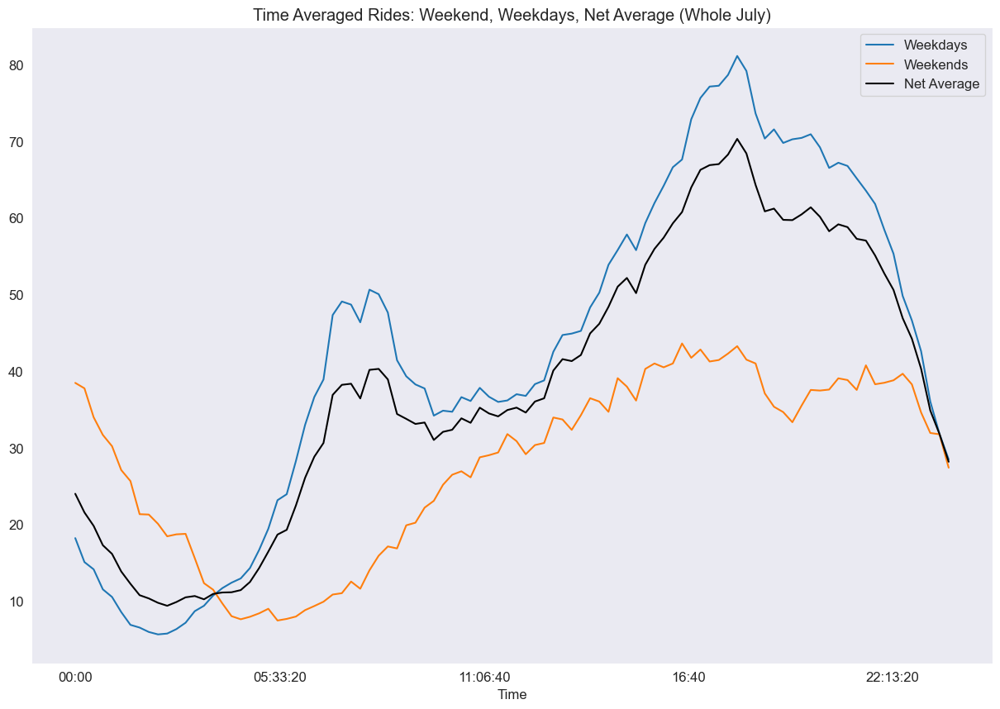

In [99]:
plt.figure(figsize=(15,10))
weekdays_weekends.plot(ax=plt.gca())
weekly_data.T.mean().plot(ax=plt.gca(),c = 'black',label='Net Average')
_=plt.title('Time Averaged Rides: Weekend, Weekdays, Net Average (Whole July)')
_=plt.legend()

The Net average plot is more similar to the weekdays average because there are more weekdays than weekends.

In early morning, weekends have more rides. This makes sense as people often go out at night during the weekends.

The number of rides around 8 AM is less on weekends, but more on weekdays as it is usually the time when people goto work. Also, in the weekends, there is a surge in the number of evening rides as people return from work.

Let us normalize the weekday and weekends data with their own respective sums. This will give us an insight into the proportional data and help us answer questions like - "What percentage of rides happened around 12AM on weekends or weekdays"?

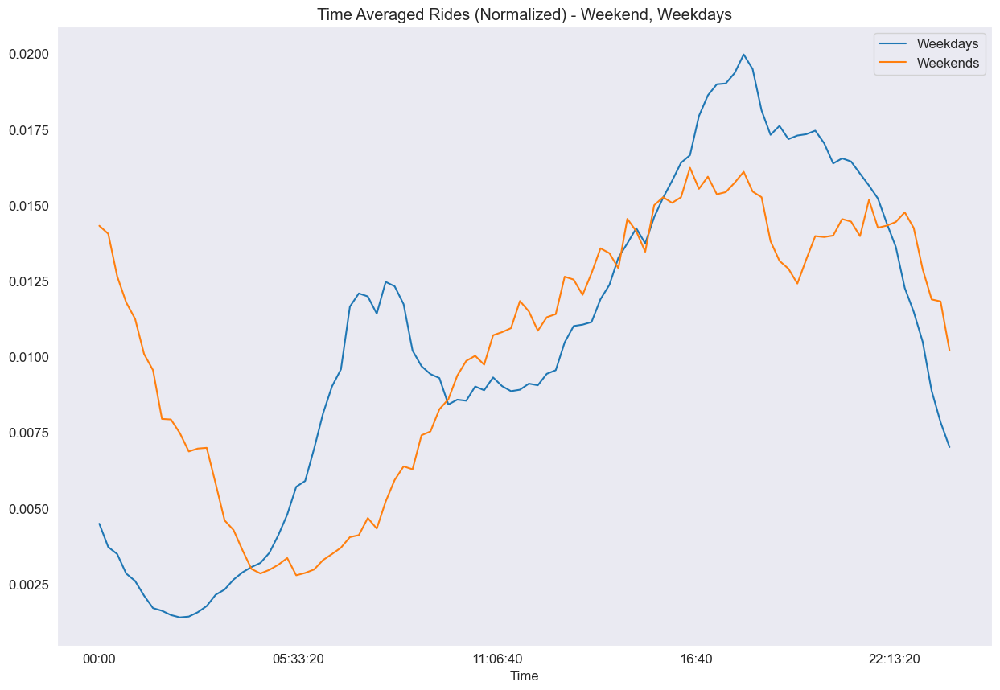

In [100]:
plt.figure(figsize=(15,10))
(weekdays_weekends/weekdays_weekends.sum()).plot(ax=plt.gca())
_=plt.title('Time Averaged Rides (Normalized) - Weekend, Weekdays')

Nearly 1.5% of the total rides on weekends happen at midnight but only 0.5% of the total rides happen on weekdays! Also, nearly 2% of the total rides on weekdays happen around 5:30PM!

So far, we have made our observations by eye. Let us do a statistical T test to compare the time-averaged rides on weekdays and weekends

In [101]:
#Grouping by date and time and creating a dataset that gives the total rides every 15 mins
for_ttest = uber_data.groupby(['Date','Time']).count()['Day'].reset_index(level=1)
#Total rides on each day in july
uber_data.groupby(['Date']).count()['Day']

Date
2014-07-01    21228
2014-07-02    26480
2014-07-03    21597
2014-07-04    14148
2014-07-05    10890
2014-07-06    11443
2014-07-07    18280
2014-07-08    25763
2014-07-09    27817
2014-07-10    30541
2014-07-11    28752
2014-07-12    25936
2014-07-13    21082
2014-07-14    27350
2014-07-15    33845
2014-07-16    28607
2014-07-17    30710
2014-07-18    29860
2014-07-19    25726
2014-07-20    21212
2014-07-21    23578
2014-07-22    29029
2014-07-23    34073
2014-07-24    32050
2014-07-25    29975
2014-07-26    27708
2014-07-27    22590
2014-07-28    23981
2014-07-29    27589
2014-07-30    30740
2014-07-31    33541
Name: Day, dtype: int64

In [102]:
#Normalizing the dataset by dividing rides in each time slot on a day by total number of rides on that day
for_ttest = pd.concat([for_ttest['Day']/uber_data.groupby(['Date']).count()['Day'],for_ttest['Time']],axis=1)

In [103]:
#renaming
for_ttest=for_ttest.rename(columns={'Day':'NormalizedRides'})

In [104]:
for_ttest

,NormalizedRides,Time
Date,,
2014-07-01,0.003015,00:00:00
2014-07-01,0.002544,00:15:00
2014-07-01,0.002402,00:30:00
2014-07-01,0.002214,00:45:00
2014-07-01,0.001602,01:00:00
...,...,...
2014-07-31,0.012433,22:45:00
2014-07-31,0.013148,23:00:00
2014-07-31,0.009869,23:15:00


In [105]:
for_ttest = pd.concat([for_ttest,pd.to_datetime(for_ttest.reset_index()['Date']).dt.day_name().to_frame().set_index(for_ttest.index).rename(columns={'Date':'Day'})],axis=1)

In [106]:
for_ttest

,NormalizedRides,Time,Day
Date,,,
2014-07-01,0.003015,00:00:00,Tuesday
2014-07-01,0.002544,00:15:00,Tuesday
2014-07-01,0.002402,00:30:00,Tuesday
2014-07-01,0.002214,00:45:00,Tuesday
2014-07-01,0.001602,01:00:00,Tuesday
...,...,...,...
2014-07-31,0.012433,22:45:00,Thursday
2014-07-31,0.013148,23:00:00,Thursday
2014-07-31,0.009869,23:15:00,Thursday


The rides are first normalized by dividing the number of rides in each time slot by the total number of rides on that day

Then they are grouped by time and split to weekend and weekdays data and a T test is applied on them.

A Null hypothesis is assumed: The average ride counts are similar for each time slot on weekends and weekdays

In [107]:
ttestvals = for_ttest.groupby('Time').apply(lambda x: ttest_ind(x[x['Day']<'Saturday']['NormalizedRides'],x[x['Day']>='Saturday']['NormalizedRides']))

In [108]:
ttestvals=pd.DataFrame(ttestvals.to_list(),index = ttestvals.index)

In [109]:
ttestvals

,statistic,pvalue
Time,,
00:00:00,-0.724083,0.474816
00:15:00,-1.058824,0.298420
00:30:00,-1.109198,0.276458
00:45:00,-1.090246,0.284581
01:00:00,-1.002041,0.324612
...,...,...
22:45:00,0.763044,0.451600
23:00:00,1.170588,0.251294
23:15:00,1.167313,0.252593


The t-statistic value is -11.5 around midnight! This means that the assumption(hypothesis) does not hold at that time. The pvalue is very low, hence the null hypthesis is rejected around midnight

Let's plot and see the values for all timeslots

if we hold a p-value threshold of 5% (confidence level = 95%), corresponding t-statistic value is 1.96

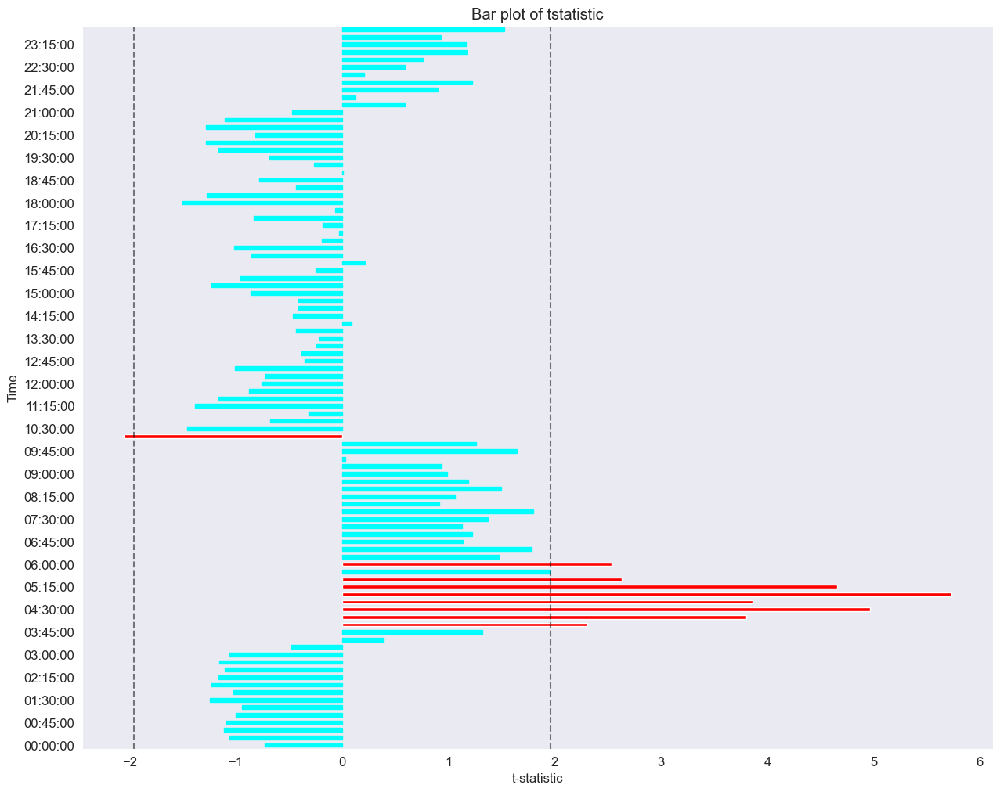

In [113]:
#Let's plot the "statistic" column
plt.figure(figsize=(15,12))
ax=ttestvals['statistic'].plot(kind='barh',color='red',ax=plt.gca())
plt.locator_params(axis='y', nbins=40)
plt.locator_params(axis='x', nbins=10)
plt.xlabel('t-statistic')
plt.axvline(x=1.96,alpha=0.5,color='black',linestyle='--')
plt.axvline(x=-1.96,alpha=0.5,color='black',linestyle='--')

for rect in ax.patches:
    if(abs(rect.get_width())<1.96):
        rect.set_color('cyan')
_=plt.title('Bar plot of tstatistic')

The time-average ride counts are assumed similar on weekdays and weekends if the width of the bar plot is less than 1.96. Such values are colored in green.

Note that their count is very low

Let's visualize a KDE plot of the pvalue to confirm this

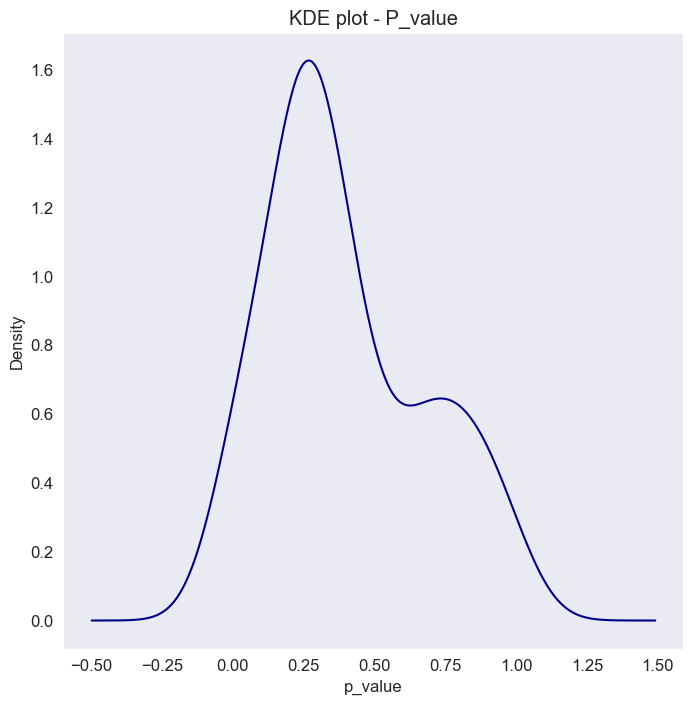

In [114]:
#KDE plot
plt.figure(figsize=(8,8))
ttestvals['pvalue'].plot(kind='kde',color='darkblue',ax=plt.gca())
plt.title('KDE plot - P_value')
_=plt.xlabel('p_value')

Density peaks around p_value=0. Hence it confirms that the time-averaged rides vary greatly at most time slots on weekends and weekdays

P-value distribution:

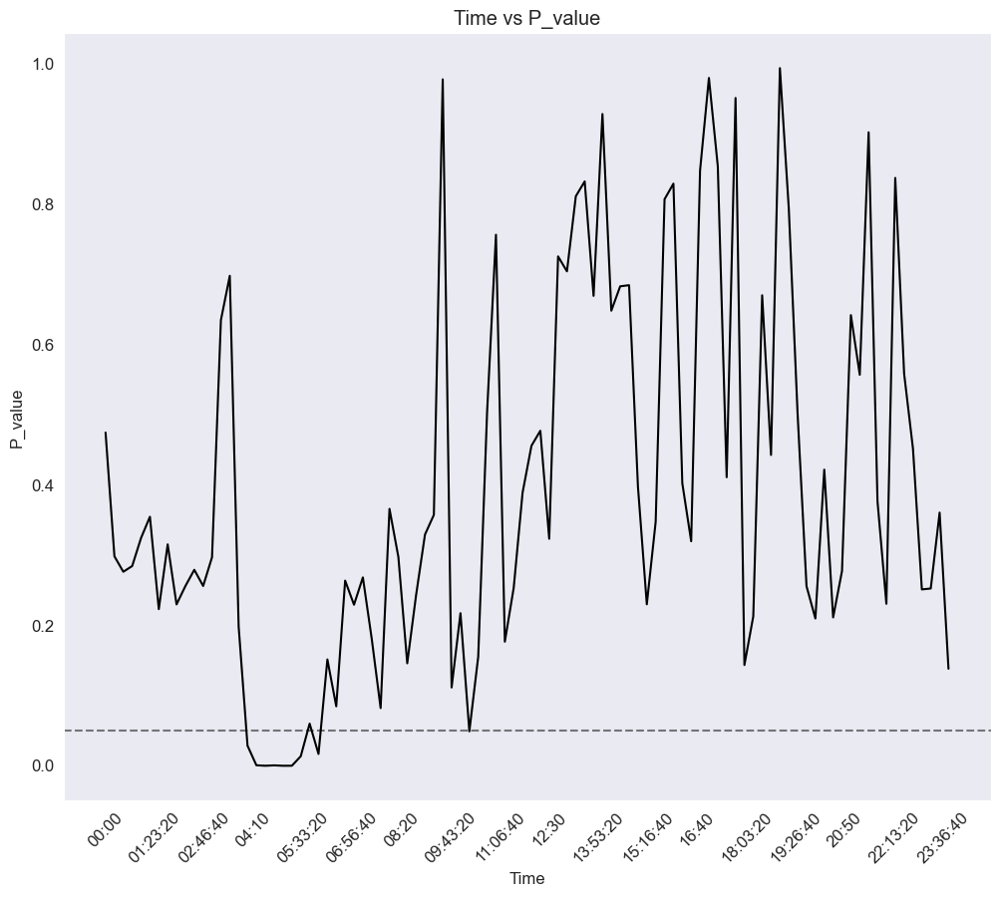

In [115]:
plt.figure(figsize=(12,10))
ax=ttestvals['pvalue'].plot(kind='line',color='black',ax=plt.gca())
plt.axhline(y=0.05,alpha=0.5,color='black',linestyle='--')
plt.locator_params(axis='x',nbins=20)
for item in plt.gca().get_xticklabels():
    item.set_rotation(45)
    
_=plt.title('Time vs P_value')
_=plt.ylabel('P_value')

The threshold is p = 0.05. The null hypothesis is accepted at p_values below 0.05

In [116]:
uber_data

,Date/Time,Lat,Lon,Base,BinnedHour,Day,Date,Time,Distance MM,Distance ESB,Weight
0,2014-07-01 00:03:00,40.7586,-73.9706,B02512,2014-07-01 00:00:00,Tuesday,2014-07-01,00:00:00,1.487358,1.058178,0.5
1,2014-07-01 00:05:00,40.7605,-73.9994,B02512,2014-07-01 00:00:00,Tuesday,2014-07-01,00:00:00,2.299140,1.100642,0.5
2,2014-07-01 00:06:00,40.7320,-73.9999,B02512,2014-07-01 00:00:00,Tuesday,2014-07-01,00:00:00,3.794105,1.354266,0.5
3,2014-07-01 00:09:00,40.7635,-73.9793,B02512,2014-07-01 00:00:00,Tuesday,2014-07-01,00:00:00,1.383450,1.094999,0.5
4,2014-07-01 00:20:00,40.7204,-74.0047,B02512,2014-07-01 00:15:00,Tuesday,2014-07-01,00:15:00,4.615925,2.173858,0.5
...,...,...,...,...,...,...,...,...,...,...,...
796116,2014-07-31 23:22:00,40.7285,-73.9846,B02764,2014-07-31 23:15:00,Thursday,2014-07-31,23:15:00,3.688336,1.375205,0.5
796117,2014-07-31 23:23:00,40.7615,-73.9868,B02764,2014-07-31 23:15:00,Thursday,2014-07-31,23:15:00,1.746524,0.906320,0.5
796118,2014-07-31 23:29:00,40.6770,-73.9515,B02764,2014-07-31 23:15:00,Thursday,2014-07-31,23:15:00,7.096685,5.244699,0.5
796119,2014-07-31 23:30:00,40.7225,-74.0038,B02764,2014-07-31 23:30:00,Thursday,2014-07-31,23:30:00,4.465889,2.023519,0.5


In [117]:
#create a copy
df = uber_data.copy()

In [118]:
#get numbers of each weekday
df['WeekDay']=df['Date/Time'].dt.weekday

In [119]:
#Convert datetime to float. egs: 1:15AM will be 1.25, 12:45 will be 12.75 etc
def func(x):
    hr = float(x.hour)
    minute = int(x.minute/15)
    return hr + minute/4
df['Time']=df['Date/Time'].apply(func)

In [120]:
#Get the day number, removing month and year
df['Day']=df['Date/Time'].dt.day

In [121]:
df

,Date/Time,Lat,Lon,Base,BinnedHour,Day,Date,Time,Distance MM,Distance ESB,Weight,WeekDay
0,2014-07-01 00:03:00,40.7586,-73.9706,B02512,2014-07-01 00:00:00,1,2014-07-01,0.00,1.487358,1.058178,0.5,1
1,2014-07-01 00:05:00,40.7605,-73.9994,B02512,2014-07-01 00:00:00,1,2014-07-01,0.00,2.299140,1.100642,0.5,1
2,2014-07-01 00:06:00,40.7320,-73.9999,B02512,2014-07-01 00:00:00,1,2014-07-01,0.00,3.794105,1.354266,0.5,1
3,2014-07-01 00:09:00,40.7635,-73.9793,B02512,2014-07-01 00:00:00,1,2014-07-01,0.00,1.383450,1.094999,0.5,1
4,2014-07-01 00:20:00,40.7204,-74.0047,B02512,2014-07-01 00:15:00,1,2014-07-01,0.25,4.615925,2.173858,0.5,1
...,...,...,...,...,...,...,...,...,...,...,...,...
796116,2014-07-31 23:22:00,40.7285,-73.9846,B02764,2014-07-31 23:15:00,31,2014-07-31,23.25,3.688336,1.375205,0.5,3
796117,2014-07-31 23:23:00,40.7615,-73.9868,B02764,2014-07-31 23:15:00,31,2014-07-31,23.25,1.746524,0.906320,0.5,3
796118,2014-07-31 23:29:00,40.6770,-73.9515,B02764,2014-07-31 23:15:00,31,2014-07-31,23.25,7.096685,5.244699,0.5,3
796119,2014-07-31 23:30:00,40.7225,-74.0038,B02764,2014-07-31 23:30:00,31,2014-07-31,23.50,4.465889,2.023519,0.5,3


In [122]:
#Remove unwanted columns that were created for visualization
df = df.drop(['Date/Time','BinnedHour','Date','Distance MM','Distance ESB','Lat','Lon'],axis=1)

In [123]:
#create a redundant columns for easy counting of tolal rides
df['DropMe']=1

In [124]:
#count the number of rides for a given day, weekday number, time and base
df = df.groupby(['Day','WeekDay','Time','Base']).count()['DropMe'].reset_index().rename(columns={'DropMe':'Rides'})

In [125]:
df

,Day,WeekDay,Time,Base,Rides
0,1,1,0.00,B02512,4
1,1,1,0.00,B02598,15
2,1,1,0.00,B02617,23
3,1,1,0.00,B02682,22
4,1,1,0.25,B02512,1
...,...,...,...,...,...
14193,31,3,23.75,B02512,7
14194,31,3,23.75,B02598,83
14195,31,3,23.75,B02617,130
14196,31,3,23.75,B02682,70


In [126]:
#Weekends are given special emphasis, as their trends were very different from that on weekdays.
#so we devote a special columns indicating whether the day is weekday or not
df['Weekend']=df.apply(lambda x: 1 if(x['WeekDay']>4) else 0,axis=1)

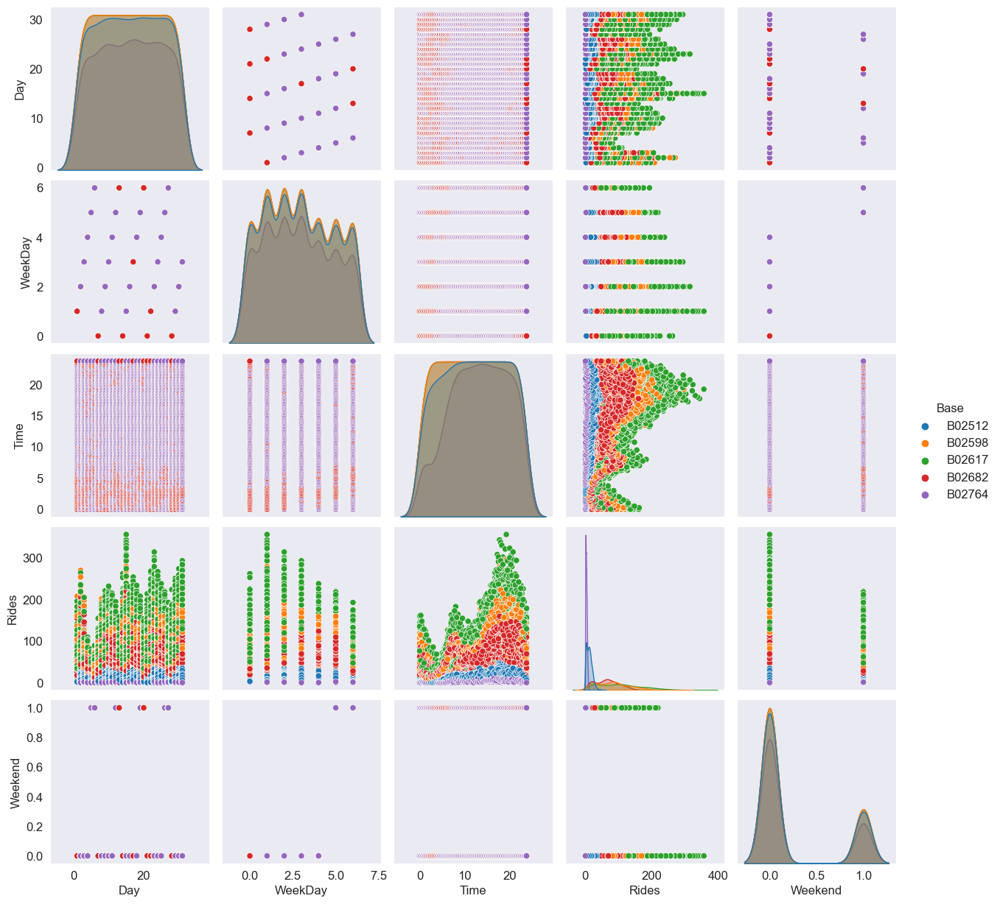

In [127]:
sns.pairplot(df,hue='Base')

<Figure size 640x480 with 0 Axes>

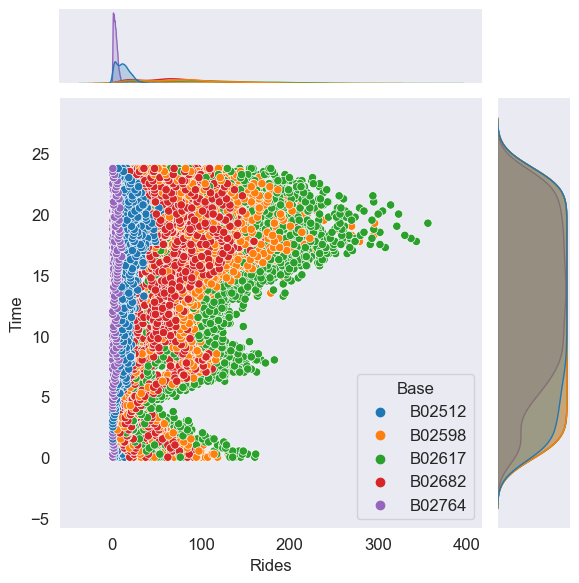

In [128]:
plt.figure()
_=sns.jointplot(x='Rides',y='Time',data = df,hue='Base')